# Sound Classification

## Introduction

Ever wondered how a Machine Learning algorithm identifies and classifies a sound? In this session, I'll start with the basics of sound, followed by its working using Machine Learning. We'll explore the sound dataset, perform analysis on it and build a multi class sound classifier using pytorch.

## Basics of sound

- Frequency
- Amplitude
- Sample Size
- Channels : Mono or Stereo- 
- Different formats of file (wav, mpeg)
- Spectrogram
- Mel-Spectrogram


## Internal of Sound Classification

TODO: Explain sound classification

## Exploratory Data Analysis

### Dataset

Name: GTZAN Dataset - Music Genre Classification
Source: https://www.kaggle.com/datasets/andradaolteanu/gtzan-dataset-music-genre-classification?resource=download

Dataset contains
- genres original folder
- images original folder
- features30seconds.csv file
- features3seconds.csv file

#### Mount Google Drive

In [ ]:
# Load data from Google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
cd '/content/drive/MyDrive/sound-classification'

/content/drive/MyDrive/sound-classification


### Install Dependencies

In [ ]:
!python --version

Python 3.7.13


In [ ]:
!pip install -r requirements.txt

ERROR: Could not find a version that satisfies the requirement shutil (from versions: none)
ERROR: No matching distribution found for shutil


In [ ]:
import sys
print(sys.path)
print(sys.executable)

['', '/content', '/env/python', '/usr/lib/python37.zip', '/usr/lib/python3.7', '/usr/lib/python3.7/lib-dynload', '/usr/local/lib/python3.7/dist-packages', '/usr/lib/python3/dist-packages', '/usr/local/lib/python3.7/dist-packages/IPython/extensions', '/root/.ipython']
/usr/bin/python3


### Import Packages

In [261]:
# Data Analysis
import numpy as np
import pandas as pd              # loading dataset
import matplotlib.pyplot as plt  # plotting library
import opendatasets as od        # download kaggle dataset
from IPython.display import Audio, display # display

# I/O
import os                        # OS related commands such as listing of directory
import shutil                    # File Copy

# Deep Neural Network and Audio processing
import torch
import torchaudio                  # accessing and processing audio 
import torch.nn as nn              # Neural network
import torch.nn.functional as F    # Functional API to create Neural Network
import torchaudio.transforms as T  # Audio transformation
import torch.onnx                  # Converting to ONNX
from torch.optim import Adam       # Optimizer
from torch.autograd import Variable # 
from torchvision.utils import make_grid # making grid
from torchvision import datasets   # loading dataset
from torchvision import transforms # transformation on image
import librosa                     # audio processing

In [ ]:
audio_backend = torchaudio.get_audio_backend()

if audio_backend == None:
    !pip install PySoundFile
    torchaudio.USE_SOUNDFILE_LEGACY_INTERFACE = False
    torchaudio.set_audio_backend("soundfile")
    
print(torchaudio.get_audio_backend())

sox_io


### Define CONSTANTS and Variables

In [ ]:
# Directory and Files
CURRENT_WORKING_DIRECTORY = os.getcwd()
DATASET_PATH = os.path.join(CURRENT_WORKING_DIRECTORY, 'gtzan-dataset-music-genre-classification', 'Data')
AUDIO_FILE_PATH = os.path.join(DATASET_PATH, 'genres_original')
AUDIO_IMAGES_FILE_PATH = os.path.join(DATASET_PATH, 'images_original')

TRAIN_AUDIO_IMAGES_FILE_PATH = os.path.join(AUDIO_IMAGES_FILE_PATH, 'train')
TEST_AUDIO_IMAGES_FILE_PATH = os.path.join(AUDIO_IMAGES_FILE_PATH, 'test')
VAL_AUDIO_IMAGES_FILE_PATH = os.path.join(AUDIO_IMAGES_FILE_PATH, 'val')

JAZZ_DIRECTORY_PATH = os.path.join(AUDIO_FILE_PATH, 'jazz')
SAMPLE_AUDIO_FILE_PATH = os.path.join(JAZZ_DIRECTORY_PATH, 'jazz.00002.wav')

FEATURES_30_SECONDS_PATH = os.path.join(DATASET_PATH, 'features_30_sec.csv')
IMAGE_FILE_EXTENSION = '.png'
AUDIO_FILE_EXTENSION = '.wav'

# Hyper parameters
HYPERPARAMETER_LR = 0.001
HYPERPARAMETER_WEIGHT_DECAY = 0.0001
HYPERPARAMETER_BATCH_SIZE = 10
HYPERPARAMETER_EPOCHS = 5

# Image settings
IMAGE_WIDTH = 288
IMAGE_HEIGHT = 432

print(SAMPLE_AUDIO_FILE_PATH)

/content/drive/MyDrive/sound-classification/gtzan-dataset-music-genre-classification/Data/genres_original/jazz/jazz.00002.wav


### Utility Functions

#### Play Audio

In [ ]:
def play_audio(waveform, sample_rate):
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  if num_channels == 1:
    display(Audio(waveform[0], rate=sample_rate))
  elif num_channels == 2:
    display(Audio((waveform[0], waveform[1]), rate=sample_rate))
  else:
    raise ValueError("Waveform with more than 2 channels are not supported.")

#### Plot Waveform

In [ ]:
### Plots waveform of an audio file
### source: https://pytorch.org/tutorials/beginner/audio_preprocessing_tutorial.html
def plot_waveform(waveform, sample_rate, title="Waveform", xlim=None, ylim=None):
  waveform = waveform.numpy()

  num_channels, num_frames = waveform.shape
  time_axis = torch.arange(0, num_frames) / sample_rate

  figure, axes = plt.subplots(num_channels, 1)
  if num_channels == 1:
    axes = [axes]
  for c in range(num_channels):
    axes[c].plot(time_axis, waveform[c], linewidth=1)
    axes[c].grid(True)
    if num_channels > 1:
      axes[c].set_ylabel(f'Channel {c+1}')
    if xlim:
      axes[c].set_xlim(xlim)
    if ylim:
      axes[c].set_ylim(ylim)
  figure.suptitle(title)
  plt.show(block=False)

#### Plot Spectrogram

In [ ]:
### Plot Spectrogram
### source: https://pytorch.org/tutorials/beginner/audio_preprocessing_tutorial.html
def plot_spectrogram(spec, title=None, ylabel='freq_bin', aspect='auto', xmax=None):
  fig, axs = plt.subplots(1, 1)
  axs.set_title(title or 'Spectrogram (db)')
  axs.set_ylabel(ylabel)
  axs.set_xlabel('frame')
  im = axs.imshow(librosa.power_to_db(spec), origin='lower', aspect=aspect)
  if xmax:
    axs.set_xlim((0, xmax))
  fig.colorbar(im, ax=axs)
  plt.show(block=False)

#### Display Image

In [ ]:
def imshow(image, ax=None, title=None, normalize=True):
    """Imshow for Tensor."""
    if ax is None:
        fig, ax = plt.subplots()
    image = image.numpy().transpose((1, 2, 0))

    if normalize:
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image = std * image + mean
        image = np.clip(image, 0, 1)

    ax.imshow(image)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.tick_params(axis='both', length=0)
    ax.set_xticklabels('')
    ax.set_yticklabels('')

    return ax

### Download Dataset

In [ ]:
if os.path.isdir(DATASET_PATH) :
 print("Directory  exists")
else:
 print("Directory not exists")
 od.download("https://www.kaggle.com/andradaolteanu/gtzan-dataset-music-genre-classification")

Directory  exists


In [ ]:
print(os.getcwd())
print(os.listdir())

/content/drive/MyDrive/sound-classification
['requirements.txt', 'gtzan-dataset-music-genre-classification', 'Sound-Classification.ipynb', 'myFirstModel.pth']


### Analysis

We will load 'features_3_sec.csv' into dataframe for analysis

In [ ]:
import pandas as pd

audio_df = pd.read_csv(FEATURES_30_SECONDS_PATH, header=0)

In [ ]:
audio_df.head()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


In [ ]:
audio_df.tail()

,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
995,rock.00095.wav,661794,0.352063,0.080487,0.079486,0.000345,2008.149458,282174.689224,2106.541053,88609.749506,...,45.050526,-13.289984,41.754955,2.484145,36.778877,-6.713265,54.866825,-1.193787,49.950665,rock
996,rock.00096.wav,661794,0.398687,0.075086,0.076458,0.000588,2006.843354,182114.709510,2068.942009,82426.016726,...,33.851742,-10.848309,39.395096,1.881229,32.010040,-7.461491,39.196327,-2.795338,31.773624,rock
997,rock.00097.wav,661794,0.432142,0.075268,0.081651,0.000322,2077.526598,231657.968040,1927.293153,74717.124394,...,33.597008,-12.845291,36.367264,3.440978,36.001110,-12.588070,42.502201,-2.106337,29.865515,rock
998,rock.00098.wav,661794,0.362485,0.091506,0.083860,0.001211,1398.699344,240318.731073,1818.450280,109090.207161,...,46.324894,-4.416050,43.583942,1.556207,34.331261,-5.041897,47.227180,-3.590644,41.299088,rock
999,rock.00099.wav,661794,0.358401,0.085884,0.054454,0.000336,1609.795082,422203.216152,1797.213044,120115.632927,...,59.167755,-7.069775,73.760391,0.028346,76.504326,-2.025783,72.189316,1.155239,49.662510,rock


In [ ]:
audio_df.shape

(1000, 60)

In [ ]:
audio_modified_df = audio_df[['filename', 'length', 'label']]
print(audio_modified_df)

            filename  length  label
0    blues.00000.wav  661794  blues
1    blues.00001.wav  661794  blues
2    blues.00002.wav  661794  blues
3    blues.00003.wav  661794  blues
4    blues.00004.wav  661794  blues
..               ...     ...    ...
995   rock.00095.wav  661794   rock
996   rock.00096.wav  661794   rock
997   rock.00097.wav  661794   rock
998   rock.00098.wav  661794   rock
999   rock.00099.wav  661794   rock

[1000 rows x 3 columns]


In [ ]:
audio_modified_df.label.value_counts()

blues        100
classical    100
country      100
disco        100
hiphop       100
jazz         100
metal        100
pop          100
reggae       100
rock         100
Name: label, dtype: int64

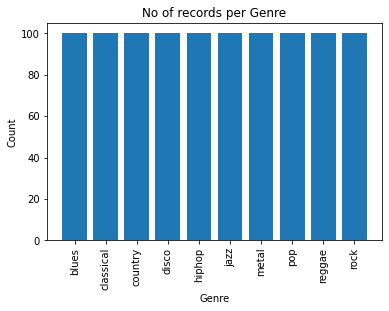

In [ ]:
classes = audio_modified_df.label.unique()
data = audio_modified_df.label.value_counts()
plt.xticks(range(len(data)), classes,rotation='vertical')
plt.xlabel('Genre')
plt.ylabel('Count')
plt.title('No of records per Genre')
plt.bar(range(len(data)), data) 
plt.show()

### Analyze Audio Data

#### Metadata

In [ ]:
metadata = torchaudio.info(SAMPLE_AUDIO_FILE_PATH)
filesizeinbytes = os.path.getsize(SAMPLE_AUDIO_FILE_PATH)
filesizeinkb = filesizeinbytes / 1024

print("************ AUDIO METADATA ***************")
print()
print("Sample Rate              :", metadata.sample_rate)
print("Number of Frames/Channel :", metadata.num_frames)
print("Number of Channels       :", metadata.num_channels)
print("Bits Depth               :", metadata.bits_per_sample)
print("Encoding Format          :", metadata.encoding)
print(f"File size                : {filesizeinbytes} bytes / {filesizeinkb:.2f} kb")
print()
print("******************************************")

************ AUDIO METADATA ***************

Sample Rate              : 22050
Number of Frames/Channel : 661794
Number of Channels       : 1
Bits Depth               : 16
Encoding Format          : PCM_S
File size                : 1323632 bytes / 1292.61 kb

******************************************


#### Waveform

In [ ]:
waveform, sample_rate = torchaudio.load(SAMPLE_AUDIO_FILE_PATH)

#### Play Audio

In [ ]:
play_audio(waveform, sample_rate)

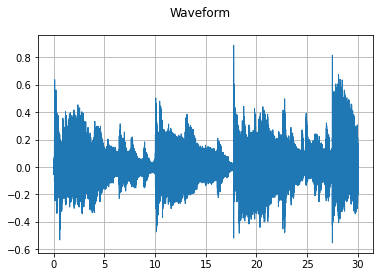

In [ ]:
plot_waveform(waveform, sample_rate)

#### Spectrogram

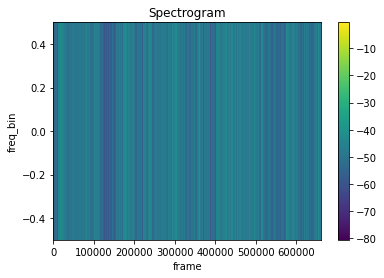

In [ ]:
plot_spectrogram(waveform, title='Spectrogram')

#### Mel-Spectrogram

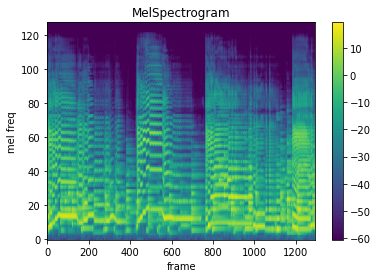

In [ ]:
n_fft = 1024
win_length = None
hop_length = 512
n_mels = 128

mel_spectrogram = T.MelSpectrogram(
    sample_rate=sample_rate,
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
    norm='slaney',
    onesided=True,
    n_mels=n_mels,
    mel_scale="htk",
)

melspec = mel_spectrogram(waveform)
plot_spectrogram(melspec[0], title="MelSpectrogram", ylabel='mel freq')

#### Audio Files Class based

In [ ]:
print()
index = 1
audiofilepaths = []
for audioclass in classes:
  audiofile = f'{audioclass}.00005.wav'
  audiofilepath = os.path.join(AUDIO_FILE_PATH, audioclass, audiofile)
  audiofilepaths.append(audiofilepath)
  print(f'{index}: {audioclass}')
  waveform, sample_rate = torchaudio.load(audiofilepath)
  play_audio(waveform, sample_rate)
  index+=1
  print()


1: blues



2: classical



3: country



4: disco



5: hiphop



6: jazz



7: metal



8: pop



9: reggae



10: rock


### Visualize images

#### Waveform

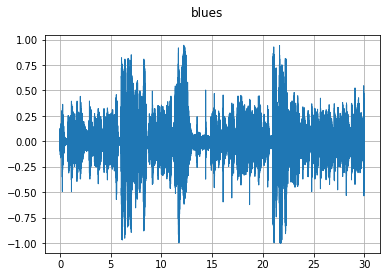

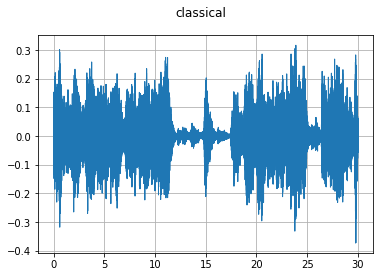

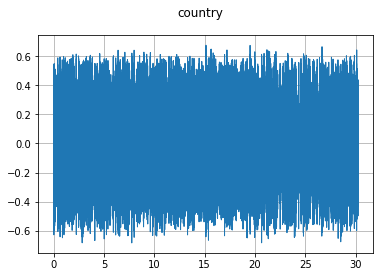

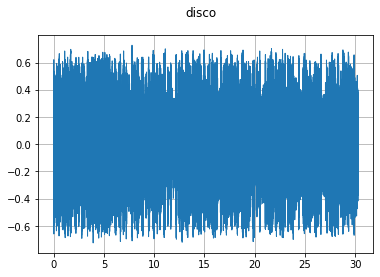

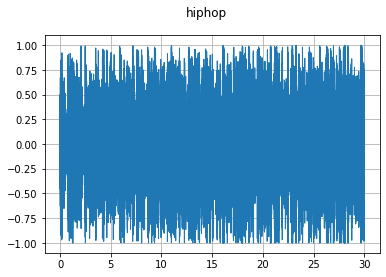

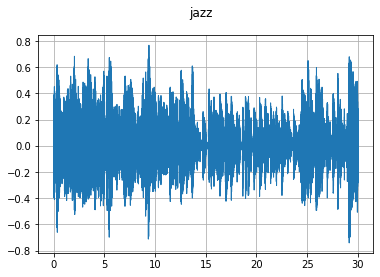

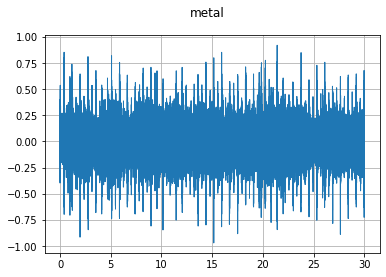

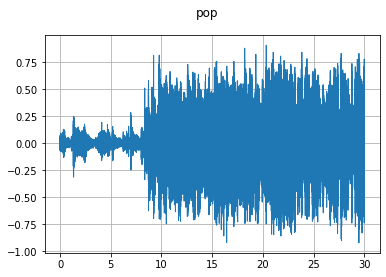

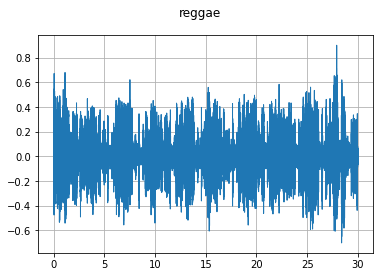

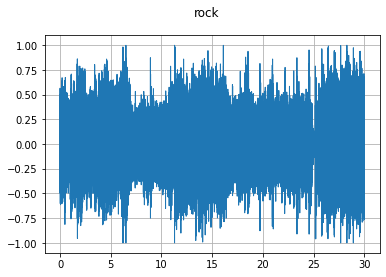

In [ ]:
print()
index = 1
for audiofilepath in audiofilepaths:
  waveform, sample_rate = torchaudio.load(audiofilepath)
  plot_waveform(waveform, sample_rate, classes[index - 1])
  index+=1
  print()

#### Spectrogram

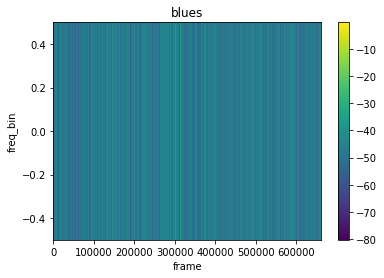

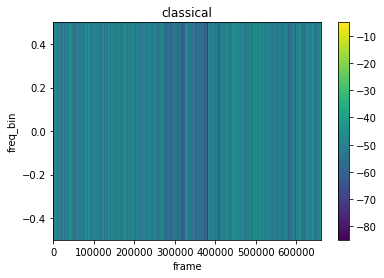

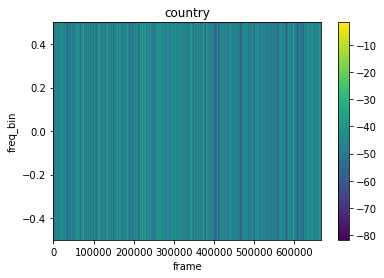

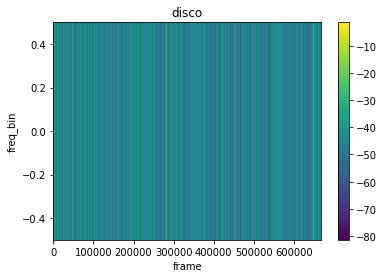

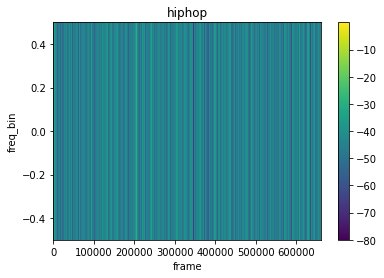

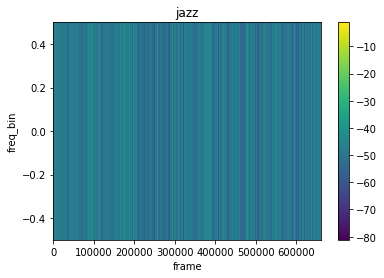

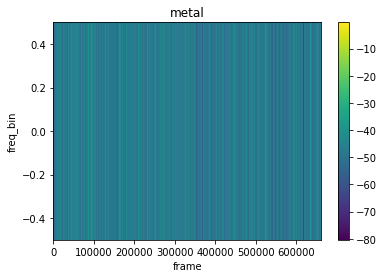

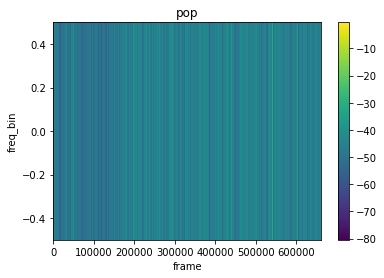

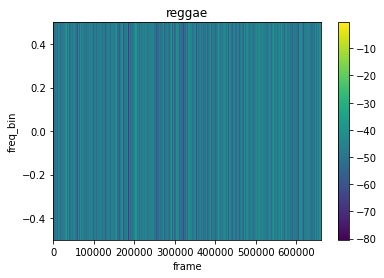

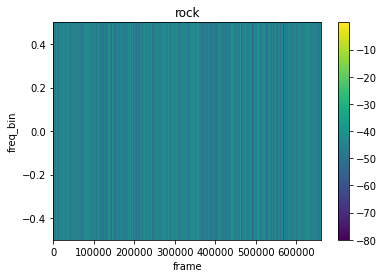

In [ ]:
print()
index = 1
for audiofilepath in audiofilepaths:
  waveform, sample_rate = torchaudio.load(audiofilepath)
  plot_spectrogram(waveform, title=classes[index - 1])
  index+=1
  print()

#### Mel-Spectrogram

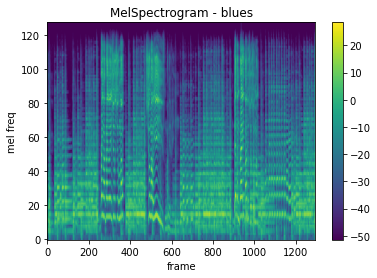

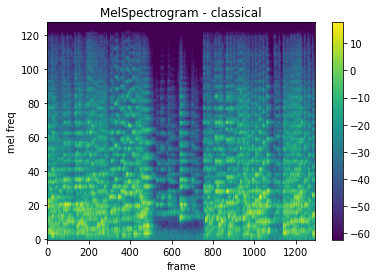

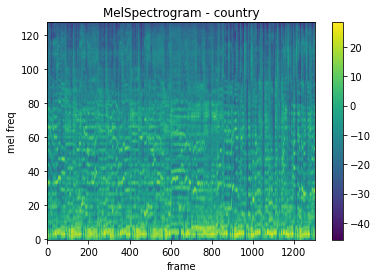

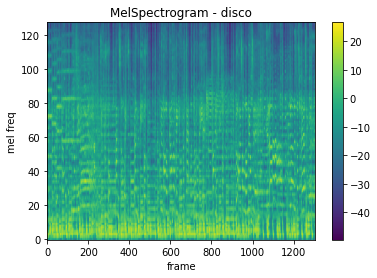

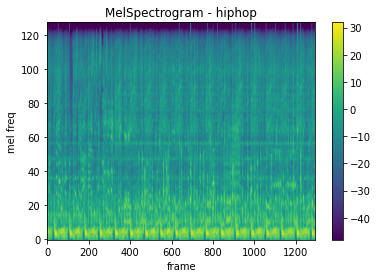

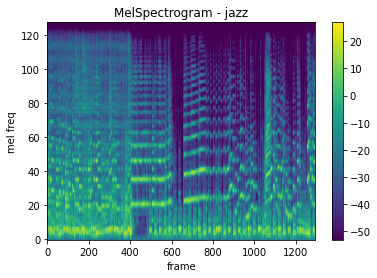

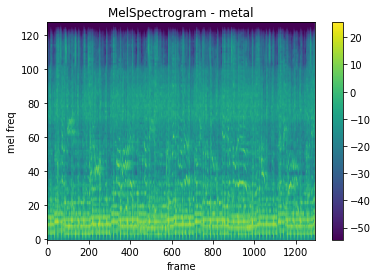

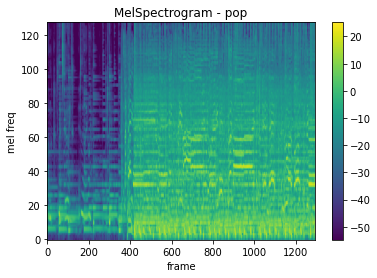

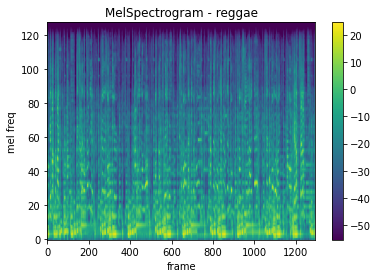

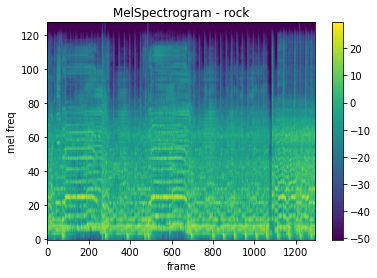

In [ ]:
print()
n_fft = 1024
win_length = None
hop_length = 512
n_mels = 128
index = 1

for audiofilepath in audiofilepaths:
  waveform, sample_rate = torchaudio.load(audiofilepath)

  mel_spectrogram = T.MelSpectrogram(
    sample_rate=sample_rate,
    n_fft=n_fft,
    win_length=win_length,
    hop_length=hop_length,
    center=True,
    pad_mode="reflect",
    power=2.0,
    norm='slaney',
    onesided=True,
    n_mels=n_mels,
    mel_scale="htk",
  )

  melspec = mel_spectrogram(waveform)
  plot_spectrogram(melspec[0], title=f"MelSpectrogram - {classes[index - 1]}", ylabel='mel freq')
  # plot_spectrogram(waveform, sample_rate)
  index+=1
  print()

## Machine learning

In [ ]:
# Load Dataset from Kaggle
# Split dataset into train and val
# Transform audio files to image
# Perform image analysis using ANN
# Perform image analysis using CNN
# Perform image analysis using transfer learning(Resnet-50)
# Validate on test dataset : Display metrics
# Evaluate sample offset on best model

### Image Classification

We'll be working on MelSpectrogram images of audio files.
Its present under 'images_original' folder.
A CNN architecture is used to classify the images as per Genre

#### Prepare Dataset

In [ ]:
checkpointfile = os.path.join(AUDIO_IMAGES_FILE_PATH, '.ipynb_checkpoints')
if os.path.exists(checkpointfile):
  os.rmdir(checkpointfile)

In [ ]:
print(AUDIO_IMAGES_FILE_PATH)
transform = transforms.Compose([
    # you can add other transformations in this list
    transforms.ToTensor()
])
dataset = datasets.ImageFolder(root=AUDIO_IMAGES_FILE_PATH, transform=transform)
print(dataset)

/content/drive/MyDrive/sound-classification/gtzan-dataset-music-genre-classification/Data/images_original
Dataset ImageFolder
    Number of datapoints: 999
    Root location: /content/drive/MyDrive/sound-classification/gtzan-dataset-music-genre-classification/Data/images_original
    StandardTransform
Transform: Compose(
               ToTensor()
           )


### Split Dataset : Train/Test/Val : 70/20/10

In [ ]:
# TRAIN
if not os.path.exists(TRAIN_AUDIO_IMAGES_FILE_PATH) :
  print("Train directory does not exists")
  os.mkdir(TRAIN_AUDIO_IMAGES_FILE_PATH)
  for label in classes:
    subdirectory = os.path.join(TRAIN_AUDIO_IMAGES_FILE_PATH, label)
    os.mkdir(subdirectory)
    # Copy files
    srcpath = os.path.join(AUDIO_IMAGES_FILE_PATH, label)
    filesinlabel = os.listdir(srcpath)
    filesinlabel = filesinlabel[0:70]
    for filename in filesinlabel:
      if filename.endswith(IMAGE_FILE_EXTENSION):
          shutil.copy(os.path.join(srcpath, filename), subdirectory)
          print(filename)

In [ ]:
# TEST
if not os.path.exists(TEST_AUDIO_IMAGES_FILE_PATH) :
  print("Test directory does not exists")
  os.mkdir(TEST_AUDIO_IMAGES_FILE_PATH)
  for label in classes:
    subdirectory = os.path.join(TEST_AUDIO_IMAGES_FILE_PATH, label)
    os.mkdir(subdirectory)
    # Copy files
    srcpath = os.path.join(AUDIO_IMAGES_FILE_PATH, label)
    filesinlabel = os.listdir(srcpath)
    filesinlabel = filesinlabel[70:90]
    for filename in filesinlabel:
      if filename.endswith(IMAGE_FILE_EXTENSION):
          shutil.copy(os.path.join(srcpath, filename), subdirectory)
          print(filename)

In [ ]:
# Validation
if not os.path.exists(VAL_AUDIO_IMAGES_FILE_PATH) :
  print("Validation directory does not exists")
  os.mkdir(VAL_AUDIO_IMAGES_FILE_PATH)
  for label in classes:
    subdirectory = os.path.join(VAL_AUDIO_IMAGES_FILE_PATH, label)
    os.mkdir(subdirectory)
    # Copy files
    srcpath = os.path.join(AUDIO_IMAGES_FILE_PATH, label)
    filesinlabel = os.listdir(srcpath)
    filesinlabel = filesinlabel[70:90]
    for filename in filesinlabel:
      if filename.endswith(IMAGE_FILE_EXTENSION):
          shutil.copy(os.path.join(srcpath, filename), subdirectory)
          print(filename)

In [ ]:
# train_set, test_set, val_set = torch.utils.data.random_split(dataset, [700, 200, 99])

In [215]:
train_set = datasets.ImageFolder(TRAIN_AUDIO_IMAGES_FILE_PATH, transform=transform)
test_set = datasets.ImageFolder(TEST_AUDIO_IMAGES_FILE_PATH, transform=transform)

In [216]:
print(len(train_set))
print(len(test_set))
# print(len(val_set))

700
200


### Load Dataset

In [217]:
train_data_loader = torch.utils.data.DataLoader(train_set,
                                          batch_size=1,
                                          shuffle=True)

test_data_loader = torch.utils.data.DataLoader(test_set,
                                          batch_size=1,
                                          shuffle=True)

### Visualize Dataset

#### Train dataset

3 : disco


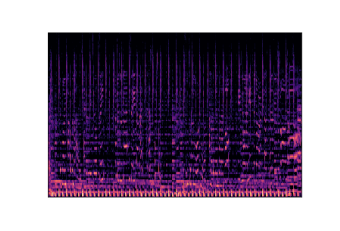

In [218]:
# Run this to test your data loader
images, labels = next(iter(train_data_loader))
classindex = labels[0].item();
# helper.imshow(images[0], normalize=False)
imshow(images[0], normalize=False)
print(f'{classindex} : {classes[classindex]}')

#### Test dataset

5 : jazz


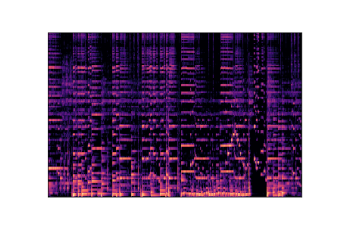

In [219]:
# Run this to test your data loader
images, labels = next(iter(test_data_loader))
classindex = labels[0].item();
imshow(images[0], normalize=False)
print(f'{classindex} : {classes[classindex]}')

#### Validation dataset

1 : classical


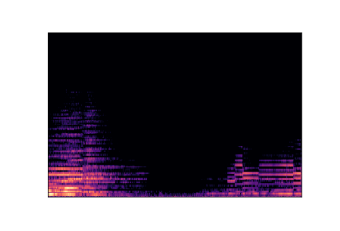

In [221]:
# Run this to test your data loader
images, labels = next(iter(test_data_loader))
classindex = labels[0].item();
imshow(images[0], normalize=False)
print(f'{classindex} : {classes[classindex]}')

### Model

#### Architecture -CNN

Conv -> BatchNorm -> ReLU -> Conv -> BatchNorm -> ReLU -> MaxPool -> Conv -> BatchNorm -> ReLU -> Conv -> BatchNorm -> ReLU -> Linear.

References
- [Microsoft - Train your model with PyTorch](https://docs.microsoft.com/en-us/windows/ai/windows-ml/tutorials/pytorch-train-model)

In [222]:
# Define a convolution neural network
class Network(nn.Module):
    def __init__(self):
        super(Network, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=12, kernel_size=5, stride=1, padding=1)
        self.bn1 = nn.BatchNorm2d(12)
        self.conv2 = nn.Conv2d(in_channels=12, out_channels=12, kernel_size=5, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(12)
        self.pool = nn.MaxPool2d(2,2)
        self.conv4 = nn.Conv2d(in_channels=12, out_channels=24, kernel_size=5, stride=1, padding=1)
        self.bn4 = nn.BatchNorm2d(24)
        self.conv5 = nn.Conv2d(in_channels=24, out_channels=24, kernel_size=5, stride=1, padding=1)
        self.bn5 = nn.BatchNorm2d(24)
        self.fc1 = nn.Linear(24*138*210, 10)

    def forward(self, input):
        # print(input.shape)
        output = F.relu(self.bn1(self.conv1(input)))      
        # print(output.shape)
        output = F.relu(self.bn2(self.conv2(output)))     
        # print(output.shape)
        output = self.pool(output)                        
        # print(output.shape)
        output = F.relu(self.bn4(self.conv4(output)))     
        # print(output.shape)
        output = F.relu(self.bn5(self.conv5(output)))  
        # print(output.shape)   
        output = output.view(-1, 24*138*210)
        output = self.fc1(output)

        return output

In [223]:
# Instantiate a neural network model 
model = Network()
print(model)

Network(
  (conv1): Conv2d(3, 12, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1))
  (bn1): BatchNorm2d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(12, 12, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(12, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv4): Conv2d(12, 24, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1))
  (bn4): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv5): Conv2d(24, 24, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1))
  (bn5): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=695520, out_features=10, bias=True)
)


### Loss Function

In [224]:
# Define the loss function with Classification Cross-Entropy loss and an optimizer with Adam optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=HYPERPARAMETER_LR, weight_decay=HYPERPARAMETER_WEIGHT_DECAY)

### Training

In [226]:
# Function to save the model
def saveModel():
    path = "./myFirstModel.pth"
    torch.save(model.state_dict(), path)

# Function to test the model with the test dataset and print the accuracy for the test images
def testAccuracy():
    
    model.eval()
    accuracy = 0.0
    total = 0.0
    
    with torch.no_grad():
        for data in test_data_loader:
            images, labels = data
            # run the model on the test set to predict labels
            outputs = model(images)
            # the label with the highest energy will be our prediction
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            accuracy += (predicted == labels).sum().item()
    
    # compute the accuracy over all test images
    accuracy = (100 * accuracy / total)
    return(accuracy)


# Training function. We simply have to loop over our data iterator and feed the inputs to the network and optimize.
def train(num_epochs):
    
    best_accuracy = 0.0

    # Define your execution device
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    print("The model will be running on", device, "device")
    # Convert model parameters and buffers to CPU or Cuda
    model.to(device)

    for epoch in range(num_epochs):  # loop over the dataset multiple times
        running_loss = 0.0
        running_acc = 0.0

        for i, (images, labels) in enumerate(train_data_loader, 0):
            
            # get the inputs
            images = Variable(images.to(device))
            labels = Variable(labels.to(device))

            # zero the parameter gradients
            optimizer.zero_grad()
            # predict classes using images from the training set
            outputs = model(images)
            # compute the loss based on model output and real labels
            loss = loss_fn(outputs, labels)
            # backpropagate the loss
            loss.backward()
            # adjust parameters based on the calculated gradients
            optimizer.step()

            # Let's print statistics for every 1,000 images
            running_loss += loss.item()     # extract the loss value
            if i % 1000 == 999:    
                # print every 1000 (twice per epoch) 
                print('[%d, %5d] loss: %.3f' %
                      (epoch + 1, i + 1, running_loss / 1000))
                # zero the loss
                running_loss = 0.0

        # Compute and print the average accuracy fo this epoch when tested over all 10000 test images
        accuracy = testAccuracy()
        print('For epoch', epoch+1,'the test accuracy over the whole test set is %d %%' % (accuracy))
        
        # we want to save the model if the accuracy is the best
        if accuracy > best_accuracy:
            saveModel()
            best_accuracy = accuracy

### Test

In [229]:
# Function to show the images
def imageshow(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()


# Function to test the model with a batch of images and show the labels predictions
def testBatch():
    # get batch of images from the test DataLoader  
    images, labels = next(iter(test_data_loader))
    print(type(images))
    print(type(labels))
    print(len(images))
    print(len(labels))

    # show all images as one image grid
    imageshow(make_grid(images))
   
    # Show the real labels on the screen 
    print('Real labels: ', ' '.join('%5s' % classes[labels[j]] 
                               for j in range(HYPERPARAMETER_BATCH_SIZE)))
  
    # Let's see what if the model identifiers the  labels of those example
    outputs = model(images)
    
    # We got the probability for every 10 labels. The highest (max) probability should be correct label
    _, predicted = torch.max(outputs, 1)
    
    # Let's show the predicted labels on the screen to compare with the real ones
    print('Predicted: ', ' '.join('%5s' % classes[predicted[j]] 
                              for j in range(HYPERPARAMETER_BATCH_SIZE)))

The model will be running on cpu device
For epoch 1 the test accuracy over the whole test set is 30 %
For epoch 2 the test accuracy over the whole test set is 22 %
For epoch 3 the test accuracy over the whole test set is 38 %
For epoch 4 the test accuracy over the whole test set is 32 %
For epoch 5 the test accuracy over the whole test set is 20 %
Finished Training
<class 'torch.Tensor'>
<class 'torch.Tensor'>
1
1


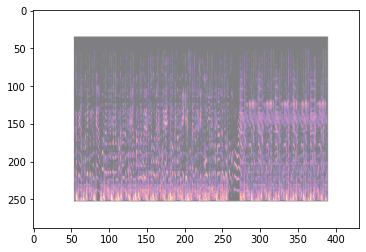

Real labels:  hiphop
Predicted:    pop


In [230]:
# Let's build our model
train(HYPERPARAMETER_EPOCHS)
print('Finished Training')

# Test which classes performed well
testAccuracy()

# Let's load the model we just created and test the accuracy per label
model = Network()
path = "myFirstModel.pth"
model.load_state_dict(torch.load(path))

# Test with batch of images
testBatch()

<class 'torch.Tensor'>
<class 'torch.Tensor'>
1
1


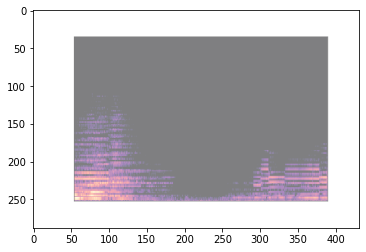

Real labels:  classical
Predicted:  classical


In [260]:
# Test with batch of images
testBatch()

In [240]:
# Function to test what classes performed well
def testClassess():
    number_of_labels = len(classes)
    class_correct = list(0. for i in range(number_of_labels))
    class_total = list(0. for i in range(number_of_labels))
    with torch.no_grad():
        for data in test_data_loader:
            images, labels = data
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            c = (predicted == labels).squeeze()
            for i in range(HYPERPARAMETER_BATCH_SIZE):
                label = labels[i].item()
                class_correct[label] += c.item() # c[i].item()
                class_total[label] += 1

    for i in range(number_of_labels):
        print('Accuracy of %5s : %2d %%' % (
            classes[i], 100 * class_correct[i] / class_total[i]))

In [241]:
testClassess()

Accuracy of blues : 25 %
Accuracy of classical : 95 %
Accuracy of country : 15 %
Accuracy of disco : 30 %
Accuracy of hiphop : 65 %
Accuracy of  jazz : 10 %
Accuracy of metal : 30 %
Accuracy of   pop : 45 %
Accuracy of reggae :  0 %
Accuracy of  rock : 30 %


### Convert to ONNX

In [266]:
#Function to Convert to ONNX 
def Convert_ONNX(): 

    # set the model to inference mode 
    model.eval() 

    # Let's create a dummy input tensor  
    dummy_input = torch.randn(1, 3, 432, 288, requires_grad=True)  

    # Export the model   
    torch.onnx.export(model,         # model being run 
         dummy_input,       # model input (or a tuple for multiple inputs) 
         "ImageClassifier.onnx",       # where to save the model  
         export_params=True,  # store the trained parameter weights inside the model file 
         opset_version=10,    # the ONNX version to export the model to 
         do_constant_folding=True,  # whether to execute constant folding for optimization 
         input_names = ['modelInput'],   # the model's input names 
         output_names = ['modelOutput'], # the model's output names 
         dynamic_axes={'modelInput' : {0 : 'batch_size'},    # variable length axes 
                                'modelOutput' : {0 : 'batch_size'}}) 
    print(" ") 
    print('Model has been converted to ONNX') 

In [267]:
Convert_ONNX()

 
Model has been converted to ONNX
